<a href="https://colab.research.google.com/github/XuchenSun/GAN_with_U-net_generator/blob/main/update.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [32]:
#@Xuchen Sun
#import library
#To prevent stackoverflow, please do not put so many command in one cell in ipynb
import os
import time
import tensorflow as tf
import datetime

from matplotlib import pyplot as plt# draw picture
from IPython import display

# creat a folder to store the information for fitting
log_dir="log_PixtoPixGAN_with_U-net_Generator/"

summary_writer = tf.summary.create_file_writer(
  log_dir + "fit_information/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S"))



In [33]:
#import tensorboard for display
!pip install -U tensorboard

Requirement already up-to-date: tensorboard in /usr/local/lib/python3.7/dist-packages (2.4.1)


In [34]:
## Load the dataset from berkeley
_URL = 'https://people.eecs.berkeley.edu/~tinghuiz/projects/pix2pix/datasets/facades.tar.gz'

#define path
path_to_zip = tf.keras.utils.get_file('facades.tar.gz',origin=_URL,extract=True)

PATH = os.path.join(os.path.dirname(path_to_zip), 'facades/')
print(PATH)
#define the constants
BUFFER_SIZE = 404 #set buffer_size to prevent overfitting
# if Buffer_size is bigger than 410, the GAN will be underfitting 

BATCH_SIZE = 1 # batch_size=1 means the trainig is very fast
LAMBDA = 90
OUTPUT_CHANNELS = 3 # channel=3 means it is color with rgb 
EPOCHS = 60 # set traning epochs

HEIGHT_IMAGE=256 # input of Unet must be 256*256
WIDTH_IMAGE=256


/root/.keras/datasets/facades/


In [ ]:
## raw picture is a combination and it need to cut halp
def load(raw_image_file):
  image = tf.io.read_file(raw_image_file)
  image = tf.image.decode_jpeg(image)

  width = tf.shape(image)[1] # raw picture is a combination and it need to cut halp

  width = width // 2
  real_image = image[:, :width, :]
  input_image = image[:, width:, :]

  input_image = tf.cast(input_image, tf.float32)
  real_image = tf.cast(real_image, tf.float32)

  return input_image, real_image
inp, re = load(PATH+'train/100.jpg')
def test_for_load_function():
  input_image, real_image = load(PATH+'train/51.jpg')
  # casting to int for matplotlib to show the image
  plt.figure()
  plt.imshow(input_image/255.0)
  plt.figure()
  plt.imshow(real_image/255.0)
  print("Print the image 51.jpg to test if the load function can work perfectly:  ")
  print("First image should be input image of houses between the value of 0 to 255")
  print("Second image should be real image of houses between the value of 0 to 255")


test_for_load_function()

def resize(input_image, real_image, height, width):
  input_image = tf.image.resize(input_image, [height, width],method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)
  
  real_image = tf.image.resize(real_image, [height, width],method=tf.image.ResizeMethod.NEAREST_NEIGHBOR)

  return input_image, real_image
def random_crop(input_image, real_image):
  stacked_image = tf.stack([input_image, real_image], axis=0)
  cropped_image = tf.image.random_crop(stacked_image, size=[2, HEIGHT_IMAGE, WIDTH_IMAGE, 3])

  return cropped_image[0], cropped_image[1]


# normalizing the images to [-1, 1]

def normalize(input_image, real_image):
  input_image = (input_image / 127.5) - 1
  real_image = (real_image / 127.5) - 1

  return input_image, real_image

@tf.function()
def random_jitter(input_image, real_image):
  # resizing to 286 x 286 x 3
  input_image, real_image = resize(input_image, real_image, 280, 280)

  # randomly cropping to 256 x 256 x 3
  input_image, real_image = random_crop(input_image, real_image)

  if tf.random.uniform(()) > 0.5:
    # random mirroring
    input_image = tf.image.flip_left_right(input_image)
    real_image = tf.image.flip_left_right(real_image)

  return input_image, real_image





In [36]:
#define function: 1 load   2  random jitter  3  normalize image
def load_image_train(image_file):
  input_image, real_image = load(image_file)
  print("train dataset operation: load image is finished" +'\n' )# show result
  input_image, real_image = random_jitter(input_image, real_image)
  print("train dataset operation:random-jitter image is finished"+'\n'  )
  input_image, real_image = normalize(input_image, real_image)
  print("train dataset operation: normalizing image  is finished" +'\n' )
  return input_image, real_image

def load_image_test(image_file):
  input_image, real_image = load(image_file)
  print("test dataset operation: load image is finished"+'\n'  )
  input_image, real_image = resize(input_image, real_image,HEIGHT_IMAGE, WIDTH_IMAGE)
  print("test dataset operation: resizing image to 256*256 is finished" +'\n' )
  input_image, real_image = normalize(input_image, real_image)
  print("test dataset operation: normalizing image is finished" +'\n' )
  return input_image, real_image

In [37]:
## Loading data through Pipeline and show result
train_dataset = tf.data.Dataset.list_files(PATH+'train/*.jpg')
train_dataset = train_dataset.map(load_image_train,num_parallel_calls=tf.data.AUTOTUNE)
train_dataset = train_dataset.shuffle(BUFFER_SIZE)#BUFFER_SIZE=300
train_dataset = train_dataset.batch(BATCH_SIZE)#BATCH_SIZE=1

test_dataset = tf.data.Dataset.list_files(PATH+'test/*.jpg')
test_dataset = test_dataset.map(load_image_test)
test_dataset = test_dataset.batch(BATCH_SIZE)

train dataset operation: load image is finished

train dataset operation:random-jitter image is finished

train dataset operation: normalizing image  is finished

test dataset operation: load image is finished

test dataset operation: resizing image to 256*256 is finished

test dataset operation: normalizing image is finished



In [38]:

## Build the Generator(U-net type)
  
#Use U-Net architecture as generator
  
#Every data block in the encoder go through
#1Conv 2Batchnorm 3Leaky ReLU
  
#Every data block in the decoder is go through 1Transposed Conv 2Batchnorm 3Dropout 4ReLU
  
#Attention:there is skip connections between the encoder and decoder(this is why they are different).

def downsample(filters, size, apply_batchnorm=True):
  initializer = tf.random_normal_initializer(0., 0.02)

  result = tf.keras.Sequential()
  result.add(
      tf.keras.layers.Conv2D(filters, size, strides=2, padding='same',
                             kernel_initializer=initializer, use_bias=False))

  if apply_batchnorm:
    result.add(tf.keras.layers.BatchNormalization())

  result.add(tf.keras.layers.LeakyReLU())

  return result
down_model = downsample(3, 4)
down_result = down_model(tf.expand_dims(inp, 0))
print (down_result.shape)
def upsample(filters, size, apply_dropout=False):
  initializer = tf.random_normal_initializer(0., 0.02)#adjust from 0.02 to 0.01

  result = tf.keras.Sequential()
  result.add(
    tf.keras.layers.Conv2DTranspose(filters, size, strides=2,
                                    padding='same',
                                    kernel_initializer=initializer,
                                    use_bias=False))

  result.add(tf.keras.layers.BatchNormalization())

  if apply_dropout:
      result.add(tf.keras.layers.Dropout(0.5))

  result.add(tf.keras.layers.ReLU())

  return result

up_model = upsample(3, 4)
up_result = up_model(down_result)
print (up_result.shape)


(1, 128, 128, 3)
(1, 256, 256, 3)


input image size is 256*256
After using Cov2D traspos, the output image size is 256*256


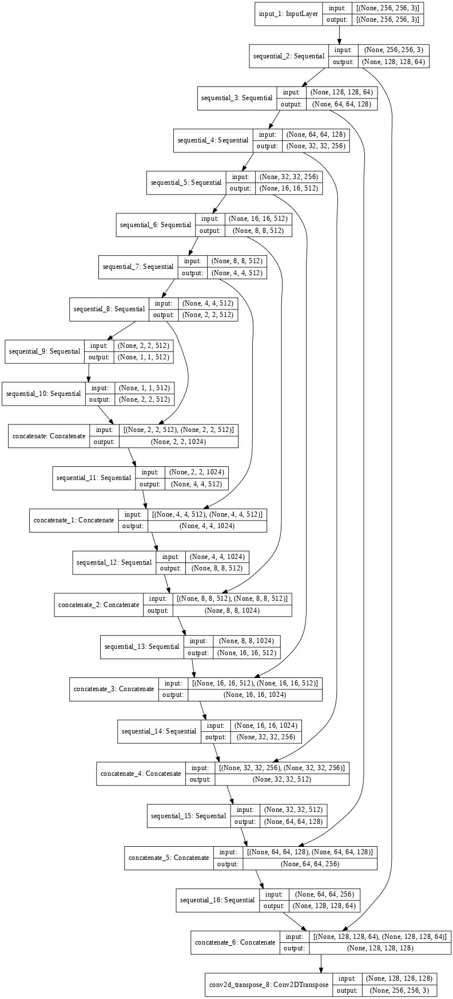

In [39]:
def Generator():
  inputs = tf.keras.layers.Input(shape=[256, 256, 3])

  down_stack = [
    downsample(64, 4, apply_batchnorm=False),  # (bs, 128, 128, 64)
    downsample(128, 4),  # (bs, 64, 64, 128)
    downsample(256, 4),  # (bs, 32, 32, 256)
    downsample(512, 4),  # (bs, 16, 16, 512)
    downsample(512, 4),  # (bs, 8, 8, 512)
    downsample(512, 4),  # (bs, 4, 4, 512)
    downsample(512, 4),  # (bs, 2, 2, 512)
    downsample(512, 4),  # (bs, 1, 1, 512)
  ]

  up_stack = [
    upsample(512, 4, apply_dropout=True),  # (bs, 2, 2, 1024)
    upsample(512, 4, apply_dropout=True),  # (bs, 4, 4, 1024)
    upsample(512, 4, apply_dropout=True),  # (bs, 8, 8, 1024)
    upsample(512, 4),  # (bs, 16, 16, 1024)
    upsample(256, 4),  # (bs, 32, 32, 512)
    upsample(128, 4),  # (bs, 64, 64, 256)
    upsample(64, 4),  # (bs, 128, 128, 128)
  ]

  initializer = tf.random_normal_initializer(0., 0.02)
  last = tf.keras.layers.Conv2DTranspose(OUTPUT_CHANNELS, 4,
                                         strides=2,
                                         padding='same',
                                         kernel_initializer=initializer,
                                         activation='tanh')  # (bs, 256, 256, 3)

  x = inputs
  # build skip connects between encoder and decoder
  # Downsampling through the model
  skips = []
  for down in down_stack:
    x = down(x)
    skips.append(x)

  skips = reversed(skips[:-1])

  # Upsampling and establishing the skip connections
  for up, skip in zip(up_stack, skips):
    x = up(x)
    x = tf.keras.layers.Concatenate()([x, skip])

  x = last(x)

  return tf.keras.Model(inputs=inputs, outputs=x)


def generator_loss(disc_generated_output, gen_output, target):
  gan_loss = loss_object(tf.ones_like(disc_generated_output), disc_generated_output)

  # mean absolute error
  l1_loss = tf.reduce_mean(tf.abs(target - gen_output))

  total_gen_loss = gan_loss + (LAMBDA * l1_loss)

  return total_gen_loss, gan_loss, l1_loss
print("input image size is 256*256")
print("After using Cov2D traspos, the output image size is 256*256")
generator = Generator()
tf.keras.utils.plot_model(generator, show_shapes=True, dpi=64)



Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


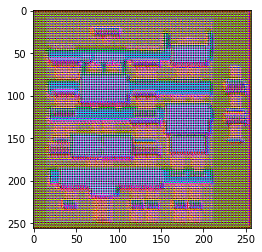

In [40]:
gen_output = generator(inp[tf.newaxis, ...], training=False)
plt.imshow(gen_output[0, ...])


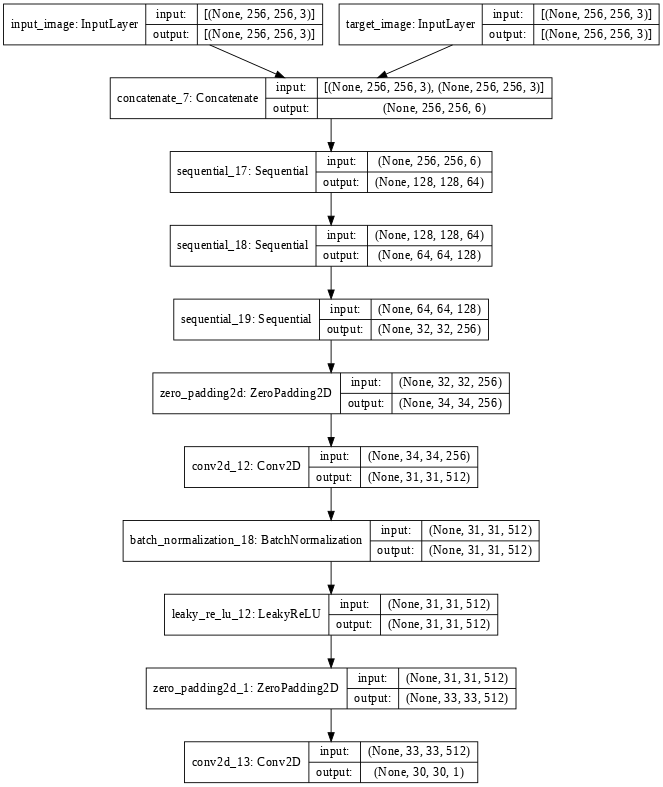

In [41]:
def Discriminator():
  initializer = tf.random_normal_initializer(0., 0.01)

  inp = tf.keras.layers.Input(shape=[256, 256, 3], name='input_image')
  tar = tf.keras.layers.Input(shape=[256, 256, 3], name='target_image')

  x = tf.keras.layers.concatenate([inp, tar])  # (bs, 256, 256, channels*2)

  down1 = downsample(64, 4, False)(x)  # (bs, 128, 128, 64)
  down2 = downsample(128, 4)(down1)  # (bs, 64, 64, 128)
  down3 = downsample(256, 4)(down2)  # (bs, 32, 32, 256)

  zero_pad1 = tf.keras.layers.ZeroPadding2D()(down3)  # (bs, 34, 34, 256)
  conv = tf.keras.layers.Conv2D(512, 4, strides=1,
                                kernel_initializer=initializer,
                                use_bias=False)(zero_pad1)  # (bs, 31, 31, 512)

  batchnorm1 = tf.keras.layers.BatchNormalization()(conv)

  leaky_relu = tf.keras.layers.LeakyReLU()(batchnorm1)

  zero_pad2 = tf.keras.layers.ZeroPadding2D()(leaky_relu)  # (bs, 33, 33, 512)

  last = tf.keras.layers.Conv2D(1, 4, strides=1,
                                kernel_initializer=initializer)(zero_pad2)  # (bs, 30, 30, 1)

  return tf.keras.Model(inputs=[inp, tar], outputs=last)

loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss
discriminator = Discriminator()
tf.keras.utils.plot_model(discriminator, show_shapes=True, dpi=64)

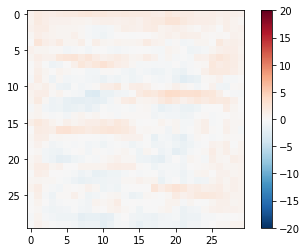

In [42]:
disc_out = discriminator([inp[tf.newaxis, ...], gen_output], training=False)
plt.imshow(disc_out[0, ..., -1], vmin=-20, vmax=20, cmap='RdBu_r')
plt.colorbar()

In [44]:
loss_object = tf.keras.losses.BinaryCrossentropy(from_logits=True)
def discriminator_loss(disc_real_output, disc_generated_output):
  real_loss = loss_object(tf.ones_like(disc_real_output), disc_real_output)

  generated_loss = loss_object(tf.zeros_like(disc_generated_output), disc_generated_output)

  total_disc_loss = real_loss + generated_loss

  return total_disc_loss

The training procedure for the discriminator is shown below.

To learn more about the architecture and the hyperparameters you can refer the [paper](https://arxiv.org/abs/1611.07004).

In [45]:
#Define the Optimizers and Checkpoint-saver
generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)

In [46]:
#Generate Images
def generate_images(model, test_input, tar):
  prediction = model(test_input, training=True)
  plt.figure(figsize=(20, 20))

  display_list = [test_input[0], tar[0], prediction[0]]
  title = ['Input Image', 'Ground Truth', 'Predicted Image']

  for i in range(3):
    plt.subplot(1, 3, i+1)
    plt.title(title[i])
    # getting the pixel values between [0, 1] to plot it.
    plt.imshow(display_list[i] * 0.5 + 0.5)
    plt.axis('off')
  plt.show()

In [47]:
# Training
@tf.function
def train_step(input_image, target, epoch):
  with tf.GradientTape() as gen_tape, tf.GradientTape() as disc_tape:
    gen_output = generator(input_image, training=True)

    disc_real_output = discriminator([input_image, target], training=True)
    disc_generated_output = discriminator([input_image, gen_output], training=True)

    gen_total_loss, gen_gan_loss, gen_l1_loss = generator_loss(disc_generated_output, gen_output, target)
    disc_loss = discriminator_loss(disc_real_output, disc_generated_output)

  generator_gradients = gen_tape.gradient(gen_total_loss,
                                          generator.trainable_variables)
  discriminator_gradients = disc_tape.gradient(disc_loss,
                                               discriminator.trainable_variables)

  generator_optimizer.apply_gradients(zip(generator_gradients,
                                          generator.trainable_variables))
  discriminator_optimizer.apply_gradients(zip(discriminator_gradients,
                                              discriminator.trainable_variables))

  with summary_writer.as_default():
    tf.summary.scalar('gen_total_loss', gen_total_loss, step=epoch)
    tf.summary.scalar('gen_gan_loss', gen_gan_loss, step=epoch)
    tf.summary.scalar('gen_l1_loss', gen_l1_loss, step=epoch)
    tf.summary.scalar('disc_loss', disc_loss, step=epoch)

In [48]:
def fit_to_Nashequilibrium(train_ds, epochs, test_ds):
  for epoch in range(epochs):
    start = time.time()

    display.clear_output(wait=True)

    for example_input, example_target in test_ds.take(1):
      generate_images(generator, example_input, example_target)
    print("Epoch: ", epoch)

    # Train
    for n, (input_image, target) in train_ds.enumerate():
      print('.', end='')
      if (n+1) % 100 == 0:
        print()
      train_step(input_image, target, epoch)
    print()

    # saving (checkpoint) the model every 20 epochs
    if (epoch + 1) % 20 == 0:
      checkpoint.save(file_prefix=checkpoint_prefix)

    print ('Time taken for epoch {} is {} sec\n'.format(epoch + 1,
                                                        time.time()-start))
  checkpoint.save(file_prefix=checkpoint_prefix)

This training loop saves logs you can easily view in TensorBoard to monitor the training progress. Working locally you would launch a separate tensorboard process. In a notebook, if you want to monitor with TensorBoard it's easiest to launch the viewer before starting the training.

To launch the viewer paste the following into a code-cell:

Now run the training loop:

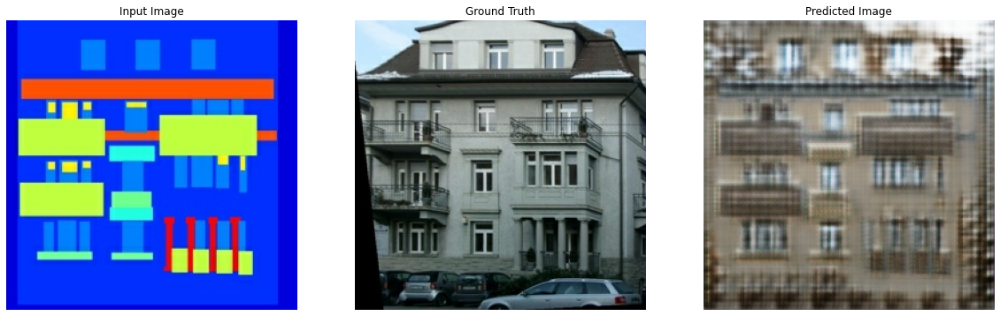

Epoch:  5


KeyboardInterrupt: ignored

In [51]:
#load the tensorboard to show the processing

%load_ext tensorboard 
%tensorboard --logdir {log_dir}
# fit function to Nash equilibrium
fit_to_Nashequilibrium(train_dataset, EPOCHS, test_dataset)

## Generate using test dataset

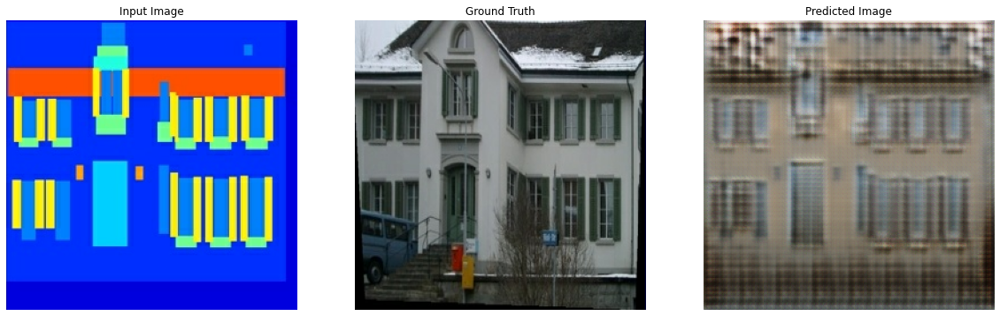

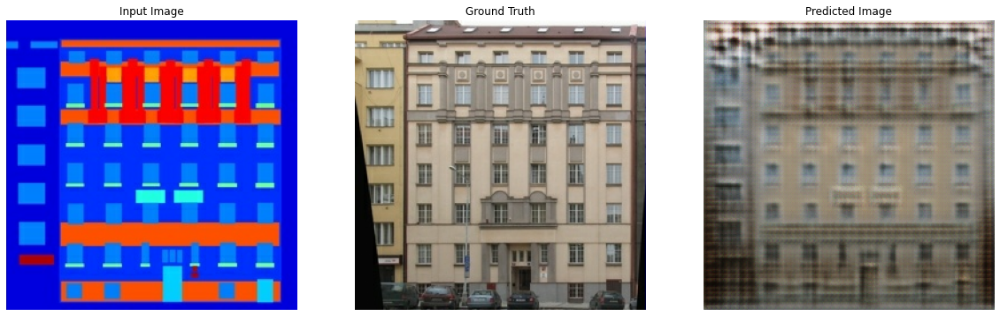

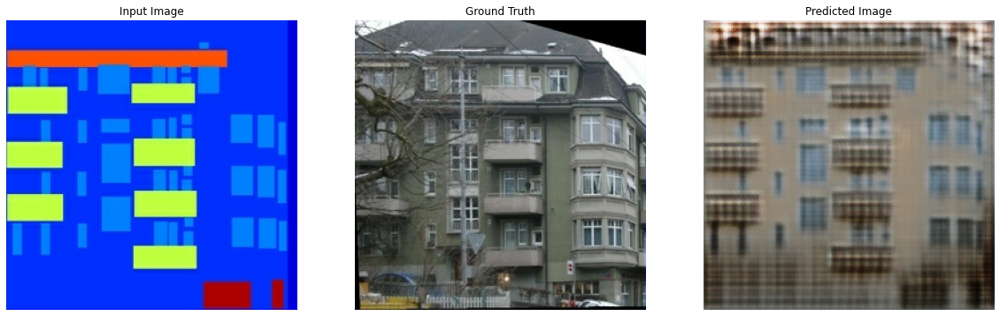

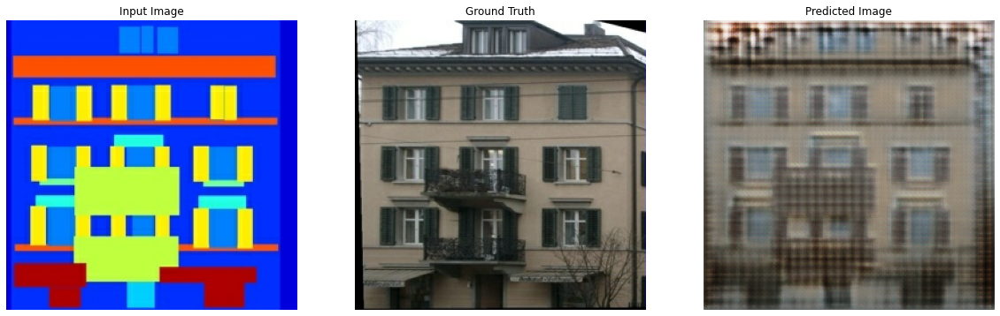

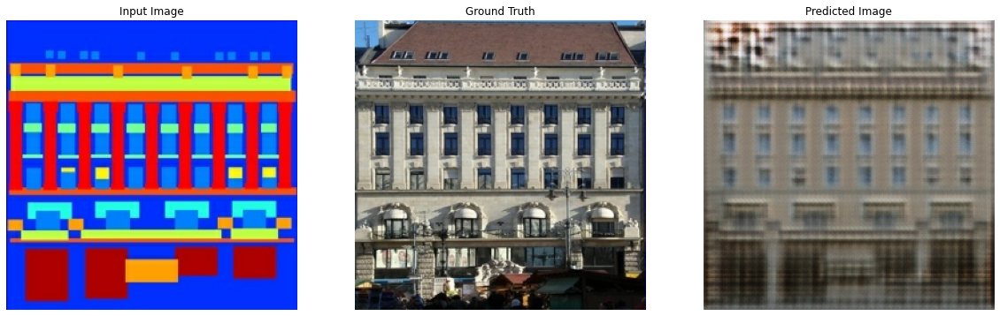

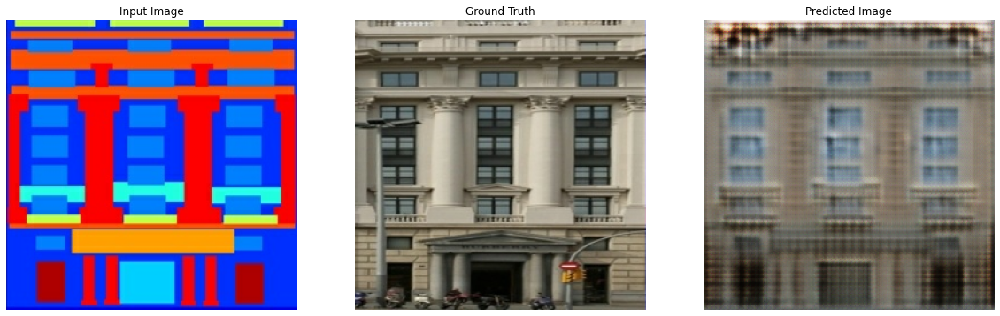

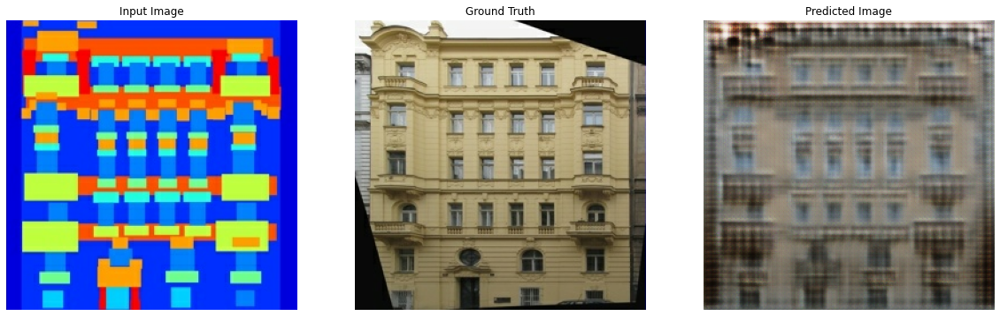

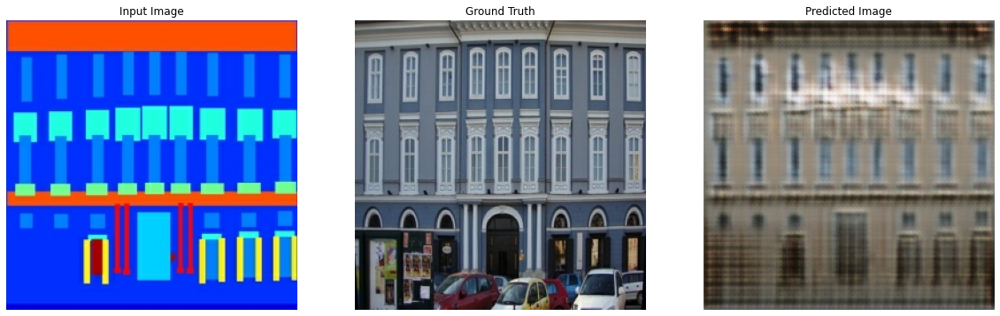

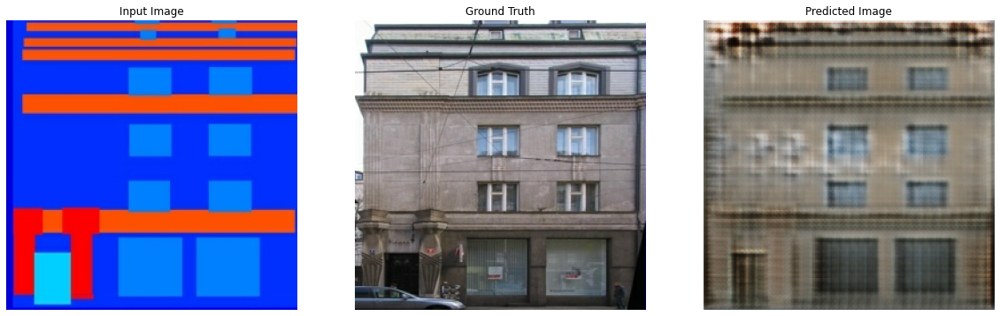

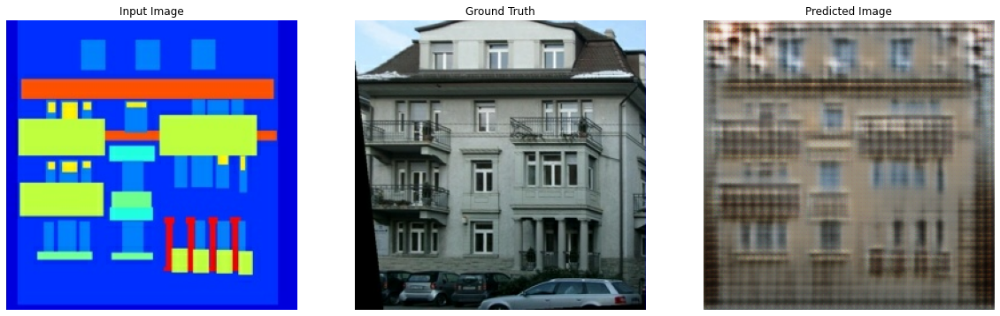

In [50]:
# Run the trained model on a few examples from the test dataset
for input, tar in test_dataset.take(10):
  generate_images(generator, input, tar)